In [1]:
import torch
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, TensorDataset
from torchvision import models, transforms

from PIL import Image

import numpy as np
import pandas as pd
import seaborn as sns
import cv2
import requests
import os
from datetime import date

from sklearn.metrics import accuracy_score, roc_auc_score, confusion_matrix, classification_report, roc_curve, f1_score, recall_score
from sklearn.model_selection import train_test_split, cross_validate, GridSearchCV
from sklearn.preprocessing import MinMaxScaler, LabelEncoder, StandardScaler, RobustScaler
from sklearn.neighbors import LocalOutlierFactor, KNeighborsClassifier
from sklearn.linear_model import LogisticRegression

import matplotlib.pyplot as plt
import missingno as msno
from matplotlib import pyplot as plt
from tqdm import tqdm

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [2]:
url = 'https://storage.googleapis.com/download.tensorflow.org/data/imagenet_class_index.json'
class_idx = requests.get(url).json()
imagenet_labels = {int(key): value[1] for key, value in class_idx.items()}

In [3]:
image_paths = [
    '/kaggle/input/dataset-hw2-q2-tai/n01614925_bald_eagle.JPEG',
    '/kaggle/input/dataset-hw2-q2-tai/n01491361_tiger_shark.JPEG',
    '/kaggle/input/dataset-hw2-q2-tai/n01532829_house_finch.JPEG',
    '/kaggle/input/pop-bottle/n03983396_pop_bottle.JPEG',
    '/kaggle/input/otritch/n01518878_ostrich.JPEG',
    '/kaggle/input/dataset-hw2-q2-tai/n02006656_spoonbill.JPEG'
]

In [4]:
model = models.vgg19(pretrained=True)
model.eval()
model = model.to(device)

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:03<00:00, 153MB/s]  


In [5]:
def preprocess_image(img_path):
    img = Image.open(img_path).convert('RGB')
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    return transform(img).unsqueeze(0).to(device)

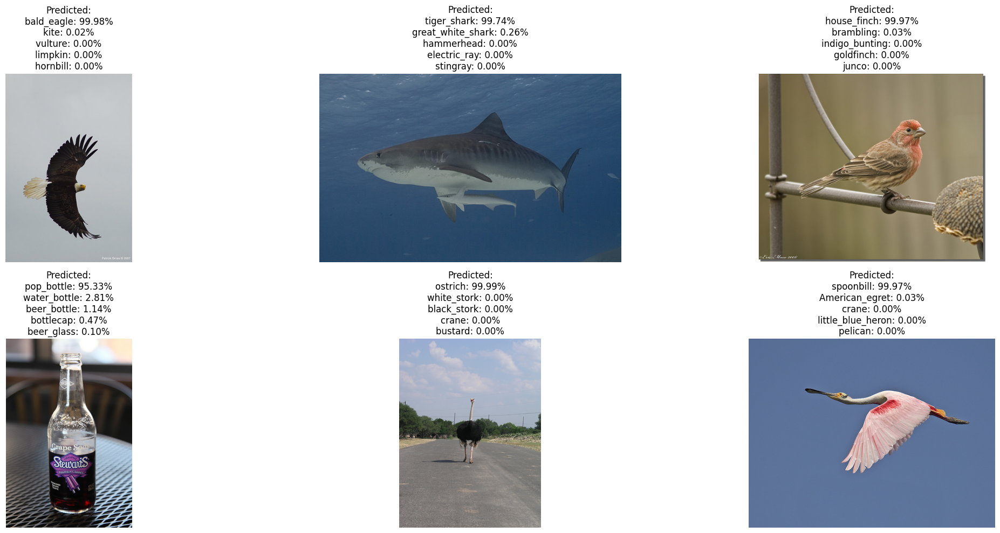

In [6]:
fig, axs = plt.subplots(2, 3, figsize=(23, 10))
sample_vars = []

for i, path in enumerate(image_paths):
    image = Image.open(path).convert('RGB')
    image_tensor = preprocess_image(path)
    with torch.no_grad():
        outputs = model(image_tensor)
        probabilities = torch.nn.functional.softmax(outputs, dim=1)
        top5_prob, top5_catid = torch.topk(probabilities, 5)
    predicted_classes = [imagenet_labels[catid] for catid in top5_catid.cpu().numpy()[0]]
    axs[i // 3, i % 3].imshow(image)
    title_text = "Predicted:\n" + "\n".join([f"{cls}: {prob*100:.2f}%" for cls, prob in zip(predicted_classes, top5_prob[0])])
    axs[i // 3, i % 3].set_title(title_text)
    axs[i // 3, i % 3].axis('off')
    globals()[f'sample{i+1}'] = image_tensor.cpu()

plt.tight_layout()
plt.show()

### Grad-CAM

In [7]:
print(model)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

In [8]:
class GradCAM:
    def __init__(self, model, target_layer):
        self.model = model
        self.target_layer = target_layer
        self.gradients = None
        self.activations = None
        self.hook_layers()

    def hook_layers(self):
        def forward_hook(module, input, output):
            self.activations = output

        def backward_hook(module, grad_in, grad_out):
            self.gradients = grad_out[0]
        layer = dict([*self.model.named_modules()])[self.target_layer]
        layer.register_forward_hook(forward_hook)
        layer.register_backward_hook(backward_hook)

    def generate_cam(self, input_tensor, target_class):
        model_output = self.model(input_tensor)
        self.model.zero_grad()
        model_output[0, target_class].backward(retain_graph=True)

        gradients = self.gradients.cpu().data.numpy()[0]
        activations = self.activations.cpu().data.numpy()[0]
        pooled_activations = np.mean(activations, axis=(1, 2))
        weights = np.mean(gradients, axis=(1, 2))
        cam = np.zeros(activations.shape[1:], dtype=np.float32)

        for i, w in enumerate(weights):
            cam += w * activations[i]

        cam = np.maximum(cam, 0)
        cam = cv2.resize(cam, (224, 224))
        cam -= cam.min()
        cam /= cam.max()
        return cam


In [9]:
def show_cam_on_image(img, mask, threshold=0.2, alpha=0.77):
    heatmap = cv2.applyColorMap(np.uint8(255 * mask), cv2.COLORMAP_JET)
    heatmap = np.float32(heatmap) / 255
    cam = heatmap * alpha + np.float32(img)
    cam = np.where(mask[..., np.newaxis] >= threshold, cam, img)
    cam = cam / np.max(cam)
    return np.uint8(255 * cam)

In [10]:
grad_cam = GradCAM(model, target_layer='features.35')

/opt/conda/lib/python3.10/site-packages/torch/nn/modules/module.py:1359: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "


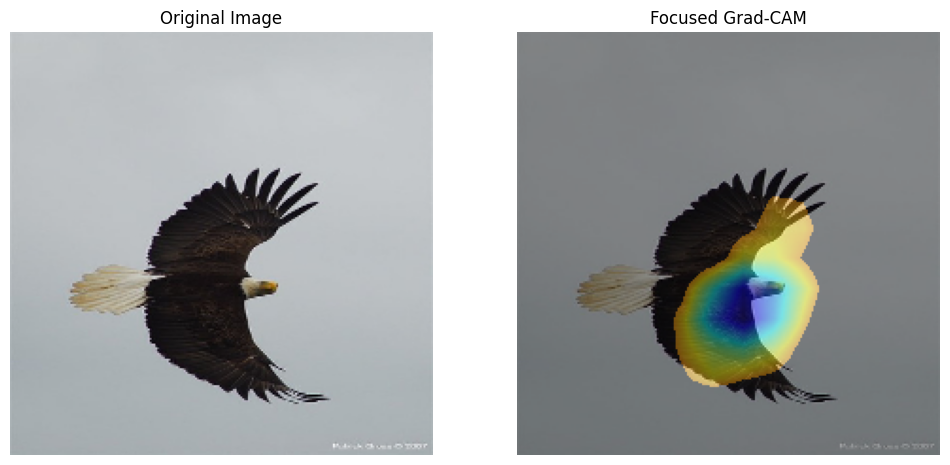

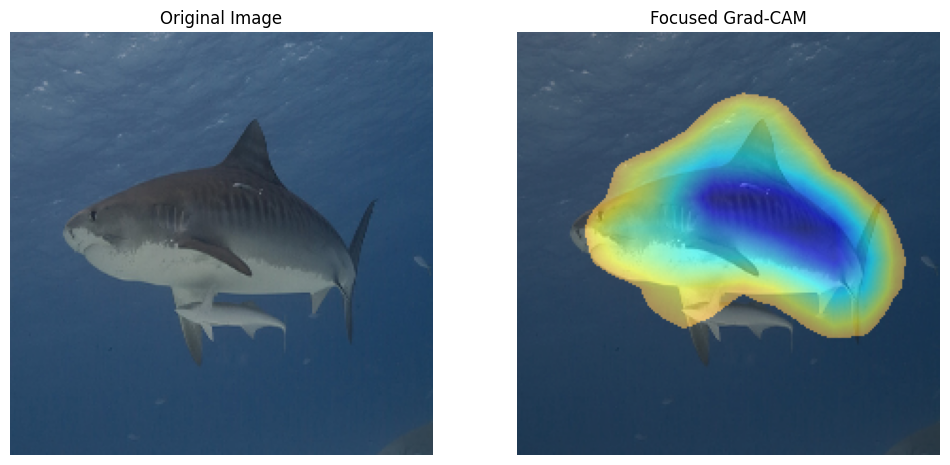

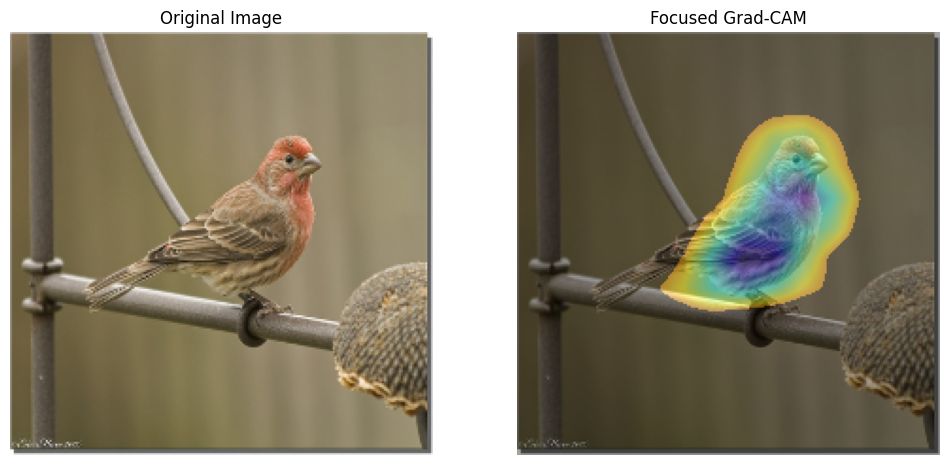

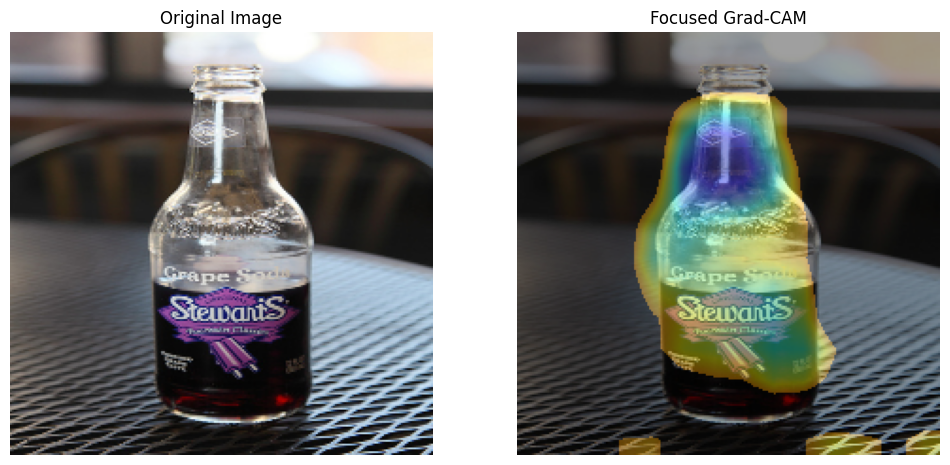

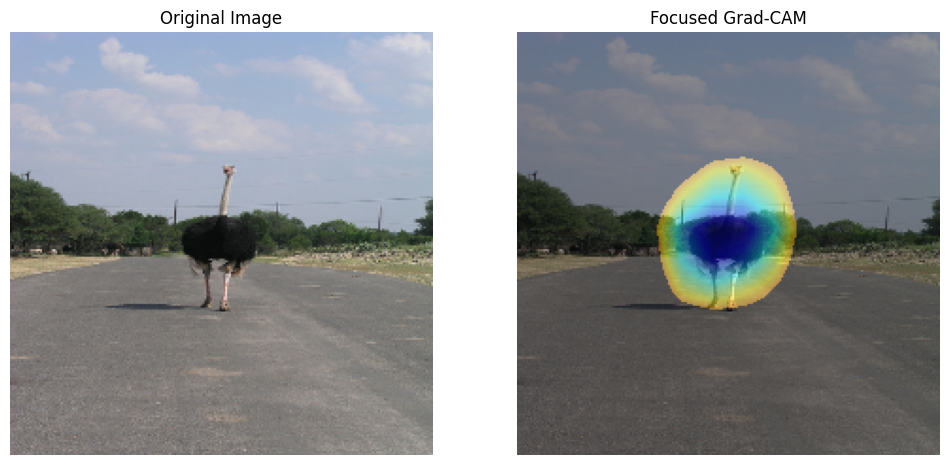

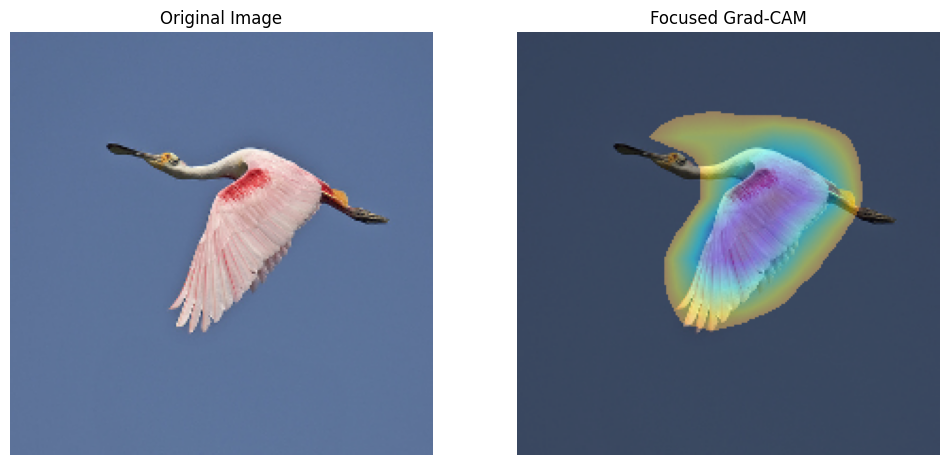

In [11]:
for img_path in image_paths:
    img = cv2.imread(img_path, 1)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = np.float32(cv2.resize(img, (224, 224))) / 255

    input_img = preprocess_image(img_path)
    output = model(input_img)
    target_class = output.argmax(dim=1).item()

    mask = grad_cam.generate_cam(input_img, target_class)
    cam_image = show_cam_on_image(img, mask, threshold=0.28, alpha=0.6)
    fig, ax = plt.subplots(1, 2, figsize=(12, 6))
    ax[0].imshow(img)
    ax[0].set_title(f"Original Image")
    ax[0].axis('off')
    ax[1].imshow(cam_image)
    ax[1].set_title(f"Focused Grad-CAM")
    ax[1].axis('off')

    plt.show()

### Guided backpropagation

In [12]:
class _BaseWrapper:
    def __init__(self, model):
        self.device = next(model.parameters()).device
        self.model = model
        self.handlers = []
    def _encode_one_hot(self, ids):
        one_hot = torch.zeros_like(self.logits).to(self.device)
        one_hot.scatter_(1, ids, 1.0)
        return one_hot

    def forward(self, image):
        self.image_shape = image.shape[2:]
        self.logits = self.model(image)
        self.probs = nn.functional.softmax(self.logits, dim=1)
        return self.probs.sort(dim=1, descending=True)
    def backward(self, ids):
        one_hot = self._encode_one_hot(ids)
        self.model.zero_grad()
        self.logits.backward(gradient=one_hot, retain_graph=True)

    def generate(self):
        raise NotImplementedError

    def remove_hook(self):
        for handle in self.handlers:
            handle.remove()

In [13]:
class GuidedBackPropagation(_BaseWrapper):
    def __init__(self, model):
        super(GuidedBackPropagation, self).__init__(model)

        def backward_hook(module, grad_in, grad_out):
            if isinstance(module, nn.ReLU):
                return (nn.functional.relu(grad_in[0]),)

        for module in self.model.named_modules():
            self.handlers.append(module[1].register_backward_hook(backward_hook))

    def generate_gradients(self, input_image, target_class):
        self.image = input_image.requires_grad_()
        self.forward(self.image)
        self.backward(torch.tensor([[target_class]], device=self.device))
        gradient = self.image.grad.clone()
        self.image.grad.zero_()
        return gradient.cpu().data.numpy()[0]

In [14]:
def convert_to_grayscale(grads):
    grayscale_grad = np.sum(np.abs(grads), axis=0)
    grayscale_grad = np.maximum(grayscale_grad, 0)
    if grayscale_grad.max() > 0:
        grayscale_grad /= grayscale_grad.max()
    return np.uint8(grayscale_grad * 255)

In [15]:
def save_and_overlay_gradient_images(original_img, gradient, file_name, overlay=True):
    gradient_resized = cv2.resize(gradient, (original_img.shape[1], original_img.shape[0]))
    gradient_resized = np.float32(gradient_resized) / 255
    gray_background = np.ones_like(original_img, dtype=np.float32) * 0.5
    mask = gradient_resized > 0.04
    if overlay:
        combined_image = gray_background.copy()
        for c in range(3):
            combined_image[:, :, c][mask] = gradient_resized[mask]
        combined_image = np.clip(combined_image * 255, 0, 255).astype(np.uint8)
    else:
        combined_image = np.clip(gradient_resized * 255, 0, 255).astype(np.uint8)
    cv2.imwrite(file_name, combined_image)

    return combined_image

In [16]:
def highlight_significant_areas(original_img, gradient, file_name):
    gradient_resized = cv2.resize(gradient, (original_img.shape[1], original_img.shape[0]))
    mask = gradient_resized > 1
    highlighted_img = np.zeros_like(original_img)
    highlighted_img[mask] = original_img[mask]
    cv2.imwrite(file_name, highlighted_img)

    return highlighted_img

In [17]:
GBP = GuidedBackPropagation(model)

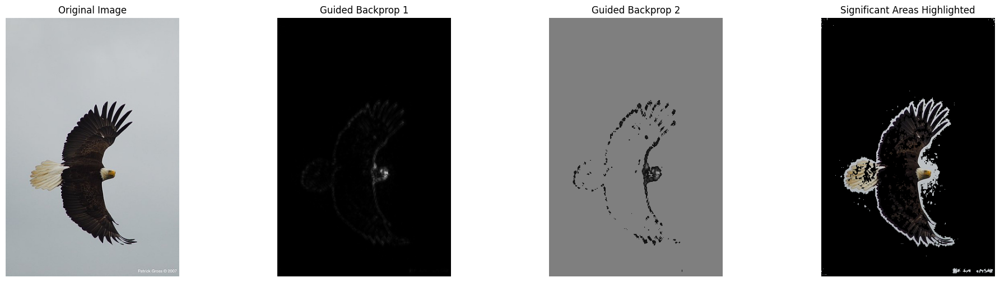

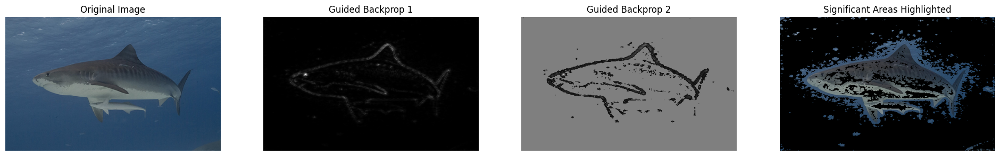

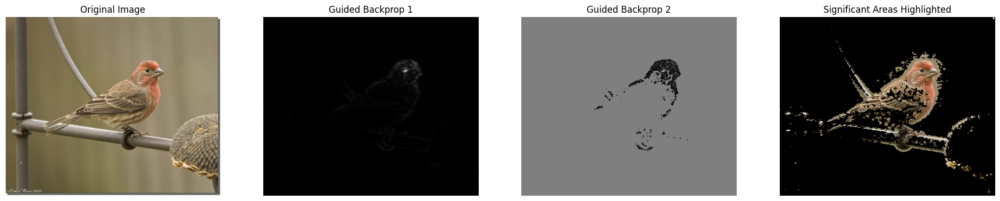

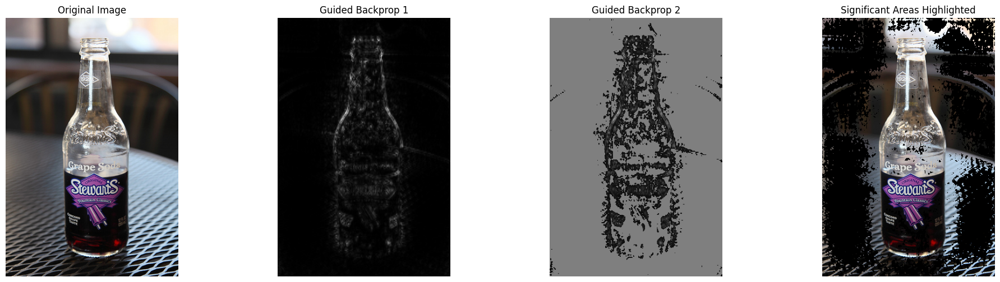

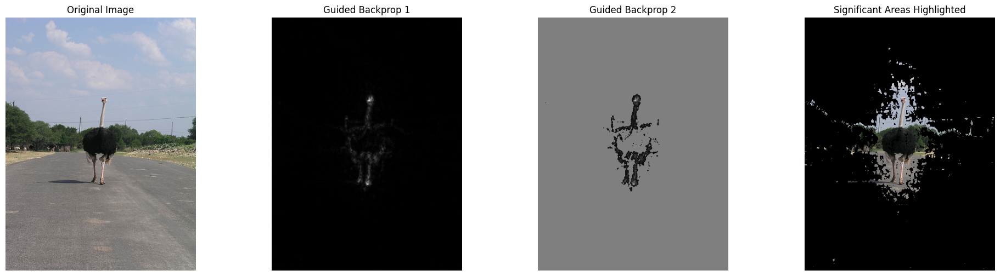

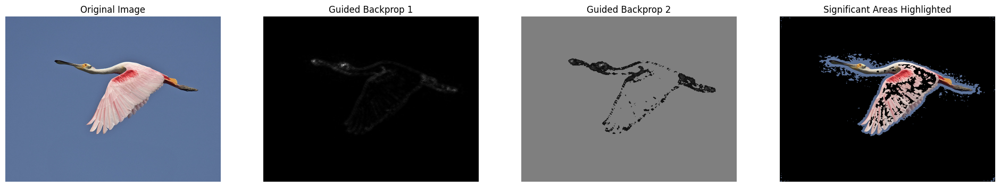

In [18]:
for img_path in image_paths:
    original_img = cv2.imread(img_path, 1)
    original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
    input_img = preprocess_image(img_path)
    output = model(input_img)
    target_class = output.argmax(dim=1).item()
    guided_grads = GBP.generate_gradients(input_img, target_class)

    grayscale_guided_grads = convert_to_grayscale(guided_grads)
    noisy_img = save_and_overlay_gradient_images(original_img, grayscale_guided_grads, 'guided_bp_noisy.png', overlay=False)
    overlay_img = save_and_overlay_gradient_images(original_img, grayscale_guided_grads, 'guided_bp_overlay.png', overlay=True)
    highlighted_img = highlight_significant_areas(original_img, grayscale_guided_grads, 'guided_bp_highlighted.png')

    fig, ax = plt.subplots(1, 4, figsize=(24, 6))

    ax[0].imshow(original_img)
    ax[0].set_title("Original Image")
    ax[0].axis('off')

    ax[1].imshow(noisy_img, cmap='gray')
    ax[1].set_title("Guided Backprop 1")
    ax[1].axis('off')

    ax[2].imshow(overlay_img)
    ax[2].set_title("Guided Backprop 2")
    ax[2].axis('off')

    ax[3].imshow(highlighted_img)
    ax[3].set_title("Significant Areas Highlighted")
    ax[3].axis('off')

    plt.show()

#Guided GRAD=CAM

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:03<00:00, 142MB/s]  


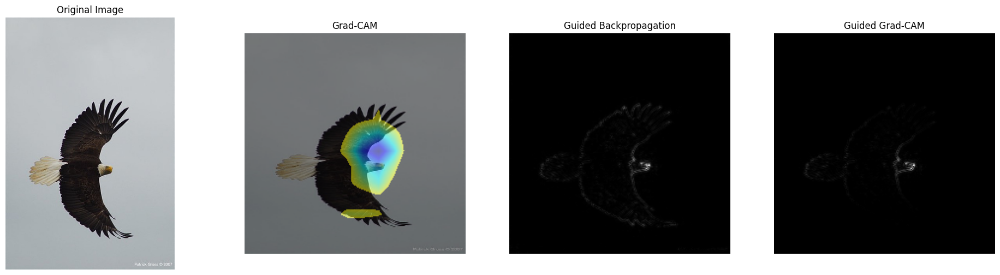

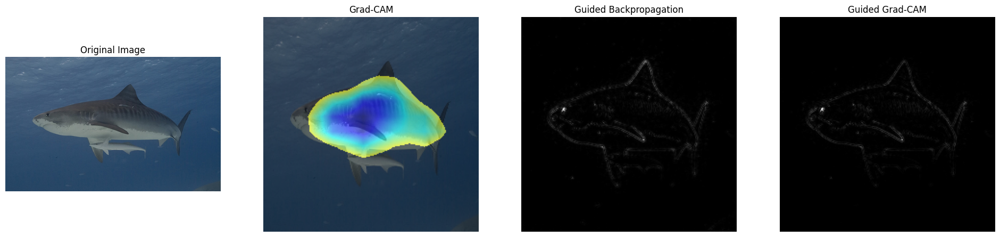

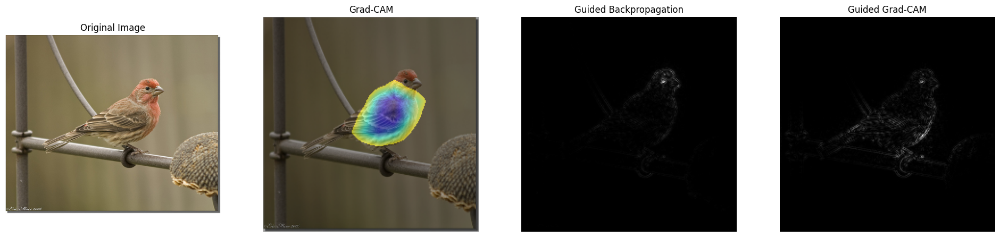

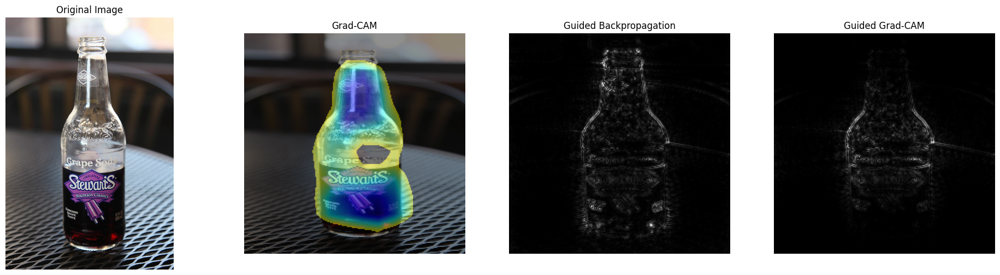

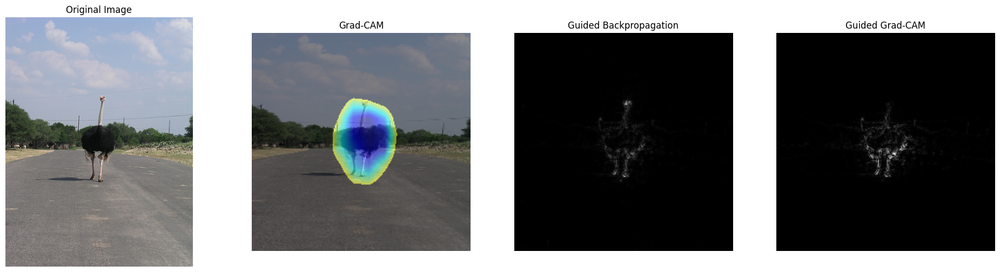

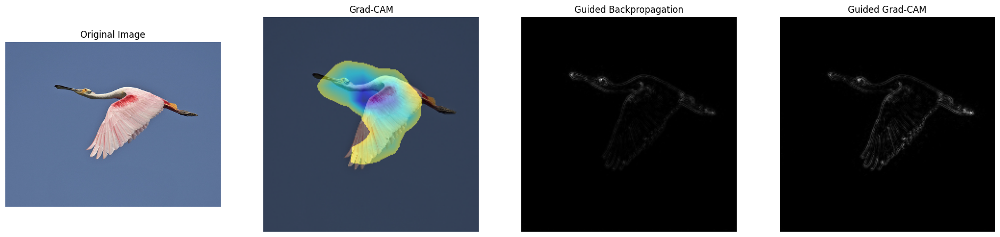

In [19]:
# Guided Backpropagation
class GuidedBackPropagation(_BaseWrapper):
    def __init__(self, model):
        super(GuidedBackPropagation, self).__init__(model)

        def backward_hook(module, grad_in, grad_out):
            if isinstance(module, nn.ReLU):
                return (F.relu(grad_in[0]),)

        for module in self.model.named_modules():
            self.handlers.append(module[1].register_backward_hook(backward_hook))

    def generate_gradients(self, input_image, target_class):
        self.image = input_image.requires_grad_()
        self.forward(self.image)
        self.backward(torch.tensor([[target_class]], device=self.device))
        gradient = self.image.grad.clone()
        self.image.grad.zero_()
        return gradient.cpu().data.numpy()[0]

def convert_to_grayscale(grads):
    grayscale_grad = np.sum(np.abs(grads), axis=0)
    grayscale_grad = np.maximum(grayscale_grad, 0)
    if grayscale_grad.max() > 0:  # Avoid division by zero
        grayscale_grad /= grayscale_grad.max()
    return np.uint8(grayscale_grad * 255)

def save_and_overlay_gradient_images(original_img, gradient, file_name, overlay=True):
    # Resize the gradient to match the original image size
    gradient_resized = cv2.resize(gradient, (original_img.shape[1], original_img.shape[0]))

    # Normalize the gradient
    gradient_resized = np.float32(gradient_resized) / 255

    # Create a gray background
    gray_background = np.ones_like(original_img, dtype=np.float32) * 0.5

    # Apply a threshold to keep only significant gradient values
    mask = gradient_resized > 0.04  # You can adjust this threshold

    if overlay:
        # Initialize the combined image with the gray background
        combined_image = gray_background.copy()

        # Combine the gradient with the gray background
        for c in range(3):
            combined_image[:, :, c][mask] = gradient_resized[mask]

        # Normalize and scale to [0, 255]
        combined_image = np.clip(combined_image * 255, 0, 255).astype(np.uint8)
    else:
        combined_image = np.clip(gradient_resized * 255, 0, 255).astype(np.uint8)

    # Save the combined image
    cv2.imwrite(file_name, combined_image)

    return combined_image

def highlight_significant_areas(original_img, gradient, file_name):
    # Resize the gradient to match the original image size
    gradient_resized = cv2.resize(gradient, (original_img.shape[1], original_img.shape[0]))

    # Apply a threshold to keep only significant gradient values
    mask = gradient_resized > 0.04  # You can adjust this threshold

    # Create an image where only the significant areas are shown
    highlighted_img = np.zeros_like(original_img)
    highlighted_img[mask] = original_img[mask]

    # Save the highlighted image
    cv2.imwrite(file_name, highlighted_img)

    return highlighted_img

# Grad-CAM
class GradCAM:
    def __init__(self, model, target_layer):
        self.model = model
        self.target_layer = target_layer
        self.gradients = None
        self.activations = None
        self.hook_layers()

    def hook_layers(self):
        def forward_hook(module, input, output):
            self.activations = output

        def backward_hook(module, grad_in, grad_out):
            self.gradients = grad_out[0]

        # Register the hooks
        layer = dict([*self.model.named_modules()])[self.target_layer]
        layer.register_forward_hook(forward_hook)
        layer.register_backward_hook(backward_hook)

    def generate_cam(self, input_tensor, target_class):
        model_output = self.model(input_tensor)
        self.model.zero_grad()
        model_output[0, target_class].backward(retain_graph=True)

        gradients = self.gradients.cpu().data.numpy()[0]
        activations = self.activations.cpu().data.numpy()[0]

        weights = np.mean(gradients, axis=(1, 2))
        cam = np.zeros(activations.shape[1:], dtype=np.float32)

        for i, w in enumerate(weights):
            cam += w * activations[i]

        cam = np.maximum(cam, 0)
        cam = cv2.resize(cam, (224, 224))
        cam -= cam.min()
        cam /= cam.max()
        return cam

def show_cam_on_image(img, mask, threshold=0.5, alpha=0.5):
    heatmap = cv2.applyColorMap(np.uint8(255 * mask), cv2.COLORMAP_JET)
    heatmap = np.float32(heatmap) / 255
    img = np.float32(cv2.resize(img, (224, 224))) / 255  # Resize img to match heatmap size
    cam = heatmap * alpha + img
    cam = np.where(mask[..., np.newaxis] >= threshold, cam, img)
    cam = cam / np.max(cam)
    return np.uint8(255 * cam)

def combine_guided_gradcam(guided_grad, gradcam_mask):
    gradcam_mask_resized = cv2.resize(gradcam_mask, (guided_grad.shape[1], guided_grad.shape[0]))
    combined = guided_grad * gradcam_mask_resized[..., np.newaxis]
    return combined

# Load pretrained VGG16 model
model = models.vgg16(pretrained=True)
model.eval()
model = model.to(device)

# Guided backpropagation
GBP = GuidedBackPropagation(model)
grad_cam = GradCAM(model, target_layer='features.29')  # Using the 30th layer (MaxPool2d)



for img_path in image_paths:
    original_img = cv2.imread(img_path, 1)
    original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
    input_img = preprocess_image(img_path)
    output = model(input_img)
    target_class = output.argmax(dim=1).item()

    # Generate Grad-CAM mask
    gradcam_mask = grad_cam.generate_cam(input_img, target_class)

    # Generate Guided Backpropagation gradients
    guided_grads = GBP.generate_gradients(input_img, target_class)
    grayscale_guided_grads = convert_to_grayscale(guided_grads)

    # Combine Guided Backpropagation with Grad-CAM
    guided_gradcam = combine_guided_gradcam(guided_grads, gradcam_mask)  # Use original guided_grads here

    # Ensure the combined image has the correct shape for display
    guided_gradcam = np.sum(np.abs(guided_gradcam), axis=0)
    guided_gradcam = np.maximum(guided_gradcam, 0)
    if guided_gradcam.max() > 0:
        guided_gradcam /= guided_gradcam.max()
    guided_gradcam = np.uint8(guided_gradcam * 255)

    # Display the original image, Grad-CAM, Guided Backpropagation, and Guided Grad-CAM
    fig, ax = plt.subplots(1, 4, figsize=(24, 6))

    # Display the original image
    ax[0].imshow(original_img)
    ax[0].set_title("Original Image")
    ax[0].axis('off')

    # Display the Grad-CAM image
    cam_image = show_cam_on_image(original_img, gradcam_mask, threshold=0.37, alpha=0.77)
    ax[1].imshow(cam_image)
    ax[1].set_title("Grad-CAM")
    ax[1].axis('off')

    # Display the Guided Backpropagation image
    ax[2].imshow(grayscale_guided_grads, cmap='gray')
    ax[2].set_title("Guided Backpropagation")
    ax[2].axis('off')

    # Display the Guided Grad-CAM image
    ax[3].imshow(guided_gradcam, cmap='gray')
    ax[3].set_title("Guided Grad-CAM")
    ax[3].axis('off')

    plt.show()


In [20]:
def combine_guided_gradcam(guided_grad, gradcam_mask):
    gradcam_mask_resized = cv2.resize(gradcam_mask, (guided_grad.shape[1], guided_grad.shape[0]))
    combined = guided_grad * gradcam_mask_resized[..., np.newaxis]
    return combined


In [21]:
def show_cam_on_image(img, mask, threshold=0.5, alpha=0.5):
    heatmap = cv2.applyColorMap(np.uint8(255 * mask), cv2.COLORMAP_JET)
    heatmap = np.float32(heatmap) / 255
    img = np.float32(cv2.resize(img, (224, 224))) / 255
    cam = heatmap * alpha + img
    cam = np.where(mask[..., np.newaxis] >= threshold, cam, img)
    cam = cam / np.max(cam)
    return np.uint8(255 * cam)

In [22]:
def combine_guided_gradcam(guided_grad, gradcam_mask):
    gradcam_mask_resized = cv2.resize(gradcam_mask, (guided_grad.shape[1], guided_grad.shape[0]))
    combined = guided_grad * gradcam_mask_resized[..., np.newaxis]
    return combined

def save_and_overlay_guided_gradcam(original_img, guided_gradcam, file_name):
    guided_gradcam_resized = cv2.resize(guided_gradcam, (original_img.shape[1], original_img.shape[0]))
    guided_gradcam_resized = np.float32(guided_gradcam_resized) / 255
    gray_background = np.ones_like(original_img, dtype=np.float32) * 0.5
    mask = guided_gradcam_resized > 0.05
    combined_image = gray_background.copy()
    for c in range(3):
        combined_image[:, :, c][mask] = guided_gradcam_resized[mask]
    combined_image = np.clip(combined_image * 255, 0, 255).astype(np.uint8)
    cv2.imwrite(file_name, combined_image)

    return combined_image

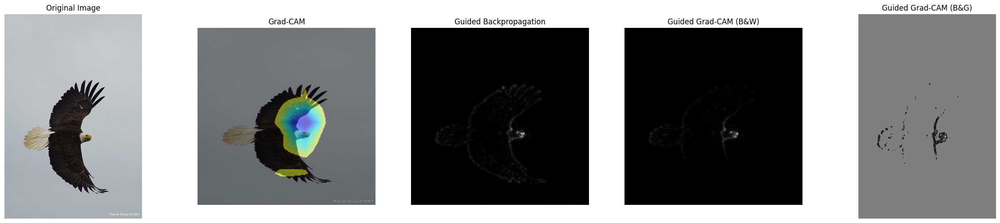

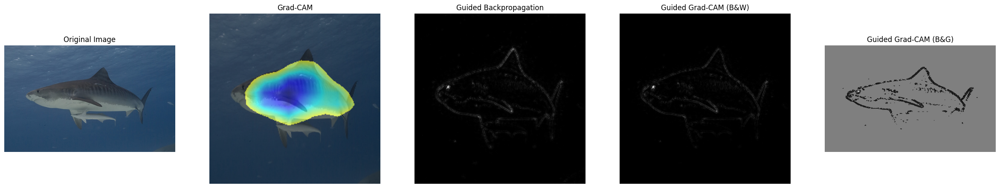

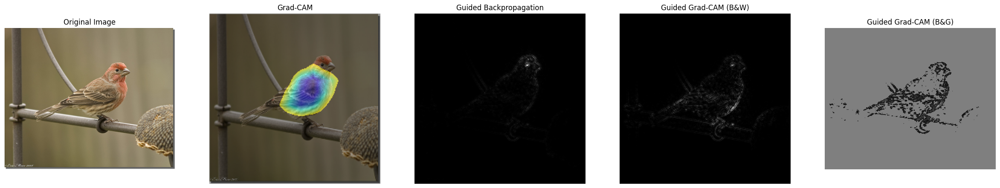

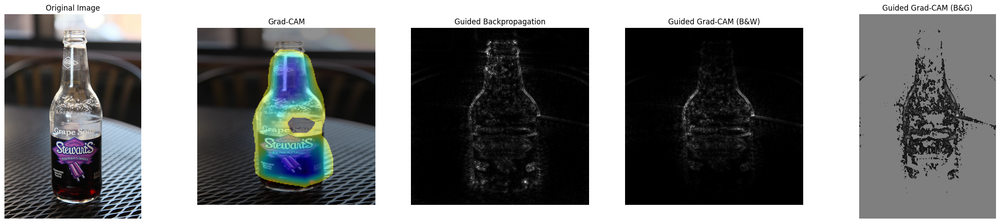

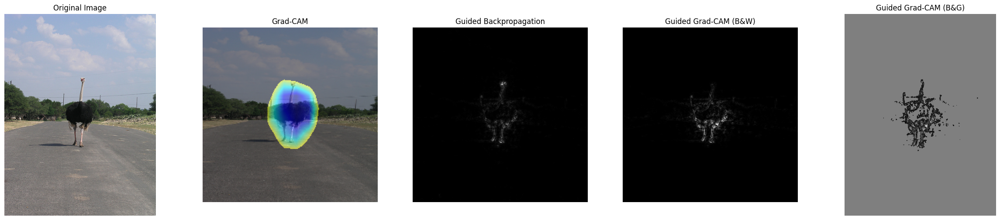

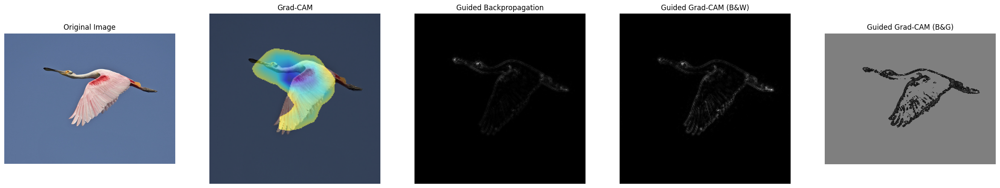

In [23]:
for img_path in image_paths:
    original_img = cv2.imread(img_path, 1)
    original_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
    input_img = preprocess_image(img_path)
    output = model(input_img)
    target_class = output.argmax(dim=1).item()

    gradcam_mask = grad_cam.generate_cam(input_img, target_class)
    guided_grads = GBP.generate_gradients(input_img, target_class)
    guided_gradcam = combine_guided_gradcam(guided_grads, gradcam_mask)
    guided_gradcam_bw = np.sum(np.abs(guided_gradcam), axis=0)
    guided_gradcam_bw = np.maximum(guided_gradcam_bw, 0)
    if guided_gradcam_bw.max() > 0:
        guided_gradcam_bw /= guided_gradcam_bw.max()
    guided_gradcam_bw = np.uint8(guided_gradcam_bw * 255)
    guided_gradcam_gray = save_and_overlay_guided_gradcam(original_img, guided_gradcam_bw, img_path.split('/')[-1].split('.')[0] + '_guided_gradcam_gray.png')
    fig, ax = plt.subplots(1, 5, figsize=(30, 6))

    ax[0].imshow(original_img)
    ax[0].set_title("Original Image")
    ax[0].axis('off')

    cam_image = show_cam_on_image(original_img, gradcam_mask, threshold=0.37, alpha=0.77)
    ax[1].imshow(cam_image)
    ax[1].set_title("Grad-CAM")
    ax[1].axis('off')

    grayscale_guided_grads = convert_to_grayscale(guided_grads)
    ax[2].imshow(grayscale_guided_grads, cmap='gray')
    ax[2].set_title("Guided Backpropagation")
    ax[2].axis('off')

    ax[3].imshow(guided_gradcam_bw, cmap='gray')
    ax[3].set_title("Guided Grad-CAM (B&W)")
    ax[3].axis('off')

    ax[4].imshow(guided_gradcam_gray)
    ax[4].set_title("Guided Grad-CAM (B&G)")
    ax[4].axis('off')

    plt.show()


In [24]:
def add_gaussian_noise(images_tensor: torch.Tensor, mean: float = 0, std: float = 1) -> torch.Tensor:
    noise = torch.randn_like(images_tensor) * std + mean
    noisy_images = images_tensor + noise
    return noisy_images


In [25]:
def normalize_image(image: np.ndarray) -> np.ndarray:
    normalized_image = (image - image.mean()) / image.std()
    normalized_image = normalized_image * 0.1 + 0.5
    normalized_image = normalized_image.clip(0, 1)
    return normalized_image


In [26]:
def smoothed_grad(image: torch.Tensor, guided_bp, add_gaussian_noise, normalize, freq: int = 20) -> (torch.Tensor, torch.Tensor):
    total_image = torch.zeros_like(image)
    original_backprop = guided_bp.visualize(image.unsqueeze(0).requires_grad_(), None)
    original_backprop = normalize(original_backprop)

    for _ in tqdm(range(freq), desc="Generating smoothed gradients"):
        noisy_image = add_gaussian_noise(image.unsqueeze(0))
        noisy_backprop = guided_bp.visualize(noisy_image.requires_grad_(), None)
        total_image += torch.tensor(noisy_backprop).permute(2, 0, 1)

    total_image = total_image / freq
    total_image = normalize(total_image)

    return original_backprop, total_image


In [27]:
def plot_images(images):
    num_images = len(images)
    fig, axs = plt.subplots(2, num_images, figsize=(20, 10))

    for i, (original, noisy) in enumerate(images):
        axs[0, i].imshow(original.permute(1, 2, 0), cmap='gray')
        axs[0, i].set_title(f'Image {i+1} - Normal Backprop')
        axs[0, i].axis('off')

        axs[1, i].imshow(noisy.permute(1, 2, 0), cmap='gray')
        axs[1, i].set_title(f'Image {i+1} - Smoothed Backprop')
        axs[1, i].axis('off')

    plt.tight_layout()
    plt.show()


Generating smoothed gradients: 100%|██████████| 6/6 [00:00<00:00, 19.47it/s]


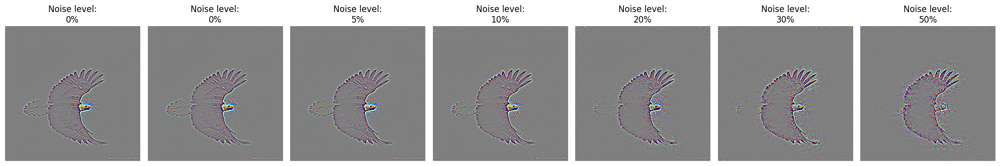

In [29]:
import torch
import torch.nn as nn
from torchvision import models, transforms
from PIL import Image
import numpy as np
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm

# Define device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

def add_gaussian_noise(images_tensor: torch.Tensor, mean: float = 0, std: float = 1) -> torch.Tensor:
    noise = torch.randn_like(images_tensor) * std + mean
    noisy_images = images_tensor + noise
    return noisy_images

def normalize_image(image: np.ndarray) -> np.ndarray:
    normalized_image = (image - image.mean()) / image.std()
    normalized_image = normalized_image * 0.1 + 0.5
    normalized_image = normalized_image.clip(0, 1)
    return normalized_image

class GuidedBackprop:
    def __init__(self, model: nn.Module):
        self.model = model
        self.image_reconstruction = None
        self.activation_maps = []
        self.model.eval()
        self.register_hooks()

    def register_hooks(self):
        def first_layer_hook_fn(module, grad_in, grad_out):
            self.image_reconstruction = grad_in[0]

        def forward_hook_fn(module, input, output):
            self.activation_maps.append(output)

        def backward_hook_fn(module, grad_in, grad_out):
            grad = self.activation_maps.pop()
            grad[grad > 0] = 1
            positive_grad_out = torch.clamp(grad_out[0], min=0.0)
            new_grad_in = positive_grad_out * grad
            return (new_grad_in,)

        for module in self.model.features.named_children():
            if isinstance(module[1], nn.ReLU):
                module[1].register_forward_hook(forward_hook_fn)
                module[1].register_backward_hook(backward_hook_fn)

        first_layer = next(iter(self.model.features.children()))
        first_layer.register_backward_hook(first_layer_hook_fn)

    def visualize(self, input_image: torch.Tensor, target_class: int = None) -> np.ndarray:
        model_output = self.model(input_image)
        self.model.zero_grad()
        pred_class = model_output.argmax().item()

        grad_target_map = torch.zeros_like(model_output, dtype=torch.float).to(device)
        grad_target_map[0][target_class if target_class is not None else pred_class] = 1

        model_output.backward(grad_target_map)
        result = self.image_reconstruction.data[0].permute(1, 2, 0)
        return result.cpu().numpy()

def smoothed_grad(image: torch.Tensor, guided_bp, add_gaussian_noise, normalize, noise_levels: list) -> list:
    results = []
    original_backprop = guided_bp.visualize(image.unsqueeze(0).requires_grad_(), None)
    original_backprop = normalize(original_backprop)

    for std in tqdm(noise_levels, desc="Generating smoothed gradients"):
        noisy_image = add_gaussian_noise(image.unsqueeze(0), std=std)
        noisy_backprop = guided_bp.visualize(noisy_image.requires_grad_(), None)
        noisy_backprop = normalize(noisy_backprop)
        results.append(noisy_backprop)

    return original_backprop, results

def preprocess_image(img_path):
    img = Image.open(img_path).convert('RGB')
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    return transform(img).unsqueeze(0).to(device)

def plot_noise_levels(image_paths, guided_bp, noise_levels):
    input_image = preprocess_image(image_paths)
    original_backprop, results = smoothed_grad(input_image.squeeze(), guided_bp, add_gaussian_noise, normalize_image, noise_levels)

    fig, axes = plt.subplots(1, len(results) + 1, figsize=(20, 5))

    axes[0].imshow(original_backprop)
    axes[0].set_title(f'Noise level:\n0%')
    axes[0].axis('off')

    for i, result in enumerate(results):
        axes[i + 1].imshow(result)
        axes[i + 1].set_title(f'Noise level:\n{int(noise_levels[i] * 100)}%')
        axes[i + 1].axis('off')

    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    image_paths = '/kaggle/input/dataset-hw2-q2-tai/n01614925_bald_eagle.JPEG'  
    noise_levels = [0.0, 0.05, 0.1, 0.2, 0.3, 0.5]  # Different noise levels

    vgg_model = models.vgg19(weights=models.VGG19_Weights.IMAGENET1K_V1).to(device)
    guided_bp = GuidedBackprop(vgg_model)

    plot_noise_levels(image_paths, guided_bp, noise_levels)


Generating smoothed gradients: 100%|██████████| 6/6 [00:00<00:00, 22.69it/s]


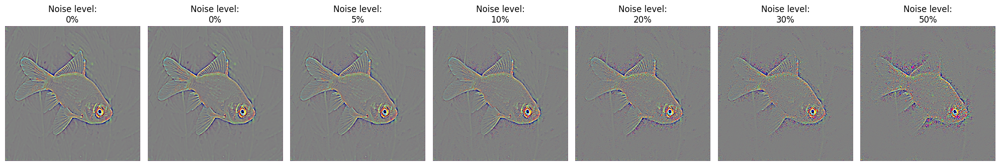

In [30]:
def plot_noise_levels(image_paths, guided_bp, noise_levels):
    input_image = preprocess_image(image_paths)
    original_backprop, results = smoothed_grad(input_image.squeeze(), guided_bp, add_gaussian_noise, normalize_image, noise_levels)

    fig, axes = plt.subplots(1, len(results) + 1, figsize=(20, 5))

    axes[0].imshow(original_backprop)
    axes[0].set_title(f'Noise level:\n0%')
    axes[0].axis('off')

    for i, result in enumerate(results):
        axes[i + 1].imshow(result)
        axes[i + 1].set_title(f'Noise level:\n{int(noise_levels[i] * 100)}%')
        axes[i + 1].axis('off')

    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    image_paths = '/kaggle/input/dataset-hw2-q2-tai/n01443537_goldfish.JPEG'  
    noise_levels = [0.0, 0.05, 0.1, 0.2, 0.3, 0.5]  # Different noise levels

    vgg_model = models.vgg19(weights=models.VGG19_Weights.IMAGENET1K_V1).to(device)
    guided_bp = GuidedBackprop(vgg_model)

    plot_noise_levels(image_paths, guided_bp, noise_levels)


Generating smoothed gradients: 100%|██████████| 6/6 [00:00<00:00, 22.87it/s]


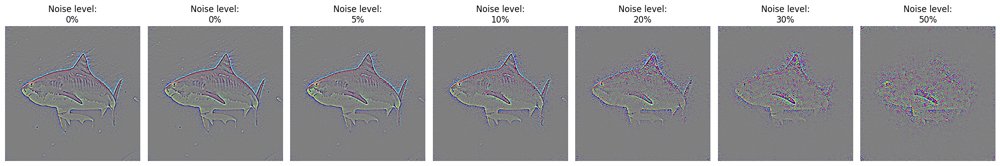

In [31]:
def plot_noise_levels(image_paths, guided_bp, noise_levels):
    input_image = preprocess_image(image_paths)
    original_backprop, results = smoothed_grad(input_image.squeeze(), guided_bp, add_gaussian_noise, normalize_image, noise_levels)

    fig, axes = plt.subplots(1, len(results) + 1, figsize=(20, 5))

    axes[0].imshow(original_backprop)
    axes[0].set_title(f'Noise level:\n0%')
    axes[0].axis('off')

    for i, result in enumerate(results):
        axes[i + 1].imshow(result)
        axes[i + 1].set_title(f'Noise level:\n{int(noise_levels[i] * 100)}%')
        axes[i + 1].axis('off')

    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    image_paths = '/kaggle/input/dataset-hw2-q2-tai/n01491361_tiger_shark.JPEG'  
    noise_levels = [0.0, 0.05, 0.1, 0.2, 0.3, 0.5]  # Different noise levels

    vgg_model = models.vgg19(weights=models.VGG19_Weights.IMAGENET1K_V1).to(device)
    guided_bp = GuidedBackprop(vgg_model)

    plot_noise_levels(image_paths, guided_bp, noise_levels)


Generating smoothed gradients: 100%|██████████| 6/6 [00:00<00:00, 23.71it/s]


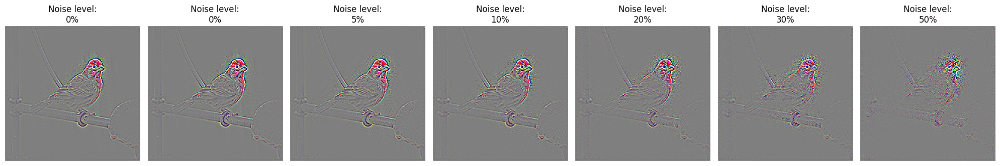

In [32]:
def plot_noise_levels(image_paths, guided_bp, noise_levels):
    input_image = preprocess_image(image_paths)
    original_backprop, results = smoothed_grad(input_image.squeeze(), guided_bp, add_gaussian_noise, normalize_image, noise_levels)

    fig, axes = plt.subplots(1, len(results) + 1, figsize=(20, 5))

    axes[0].imshow(original_backprop)
    axes[0].set_title(f'Noise level:\n0%')
    axes[0].axis('off')

    for i, result in enumerate(results):
        axes[i + 1].imshow(result)
        axes[i + 1].set_title(f'Noise level:\n{int(noise_levels[i] * 100)}%')
        axes[i + 1].axis('off')

    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    image_paths = '/kaggle/input/dataset-hw2-q2-tai/n01532829_house_finch.JPEG'  
    noise_levels = [0.0, 0.05, 0.1, 0.2, 0.3, 0.5]  # Different noise levels

    vgg_model = models.vgg19(weights=models.VGG19_Weights.IMAGENET1K_V1).to(device)
    guided_bp = GuidedBackprop(vgg_model)

    plot_noise_levels(image_paths, guided_bp, noise_levels)


Generating smoothed gradients: 100%|██████████| 6/6 [00:00<00:00, 23.22it/s]


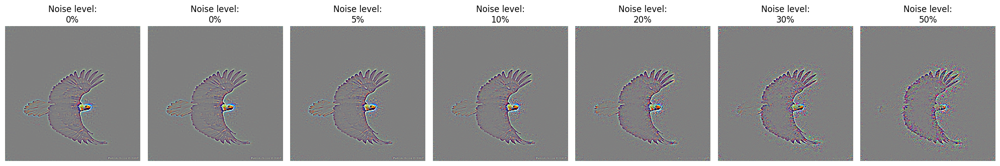

In [33]:
def plot_noise_levels(image_paths, guided_bp, noise_levels):
    input_image = preprocess_image(image_paths)
    original_backprop, results = smoothed_grad(input_image.squeeze(), guided_bp, add_gaussian_noise, normalize_image, noise_levels)

    fig, axes = plt.subplots(1, len(results) + 1, figsize=(20, 5))

    axes[0].imshow(original_backprop)
    axes[0].set_title(f'Noise level:\n0%')
    axes[0].axis('off')

    for i, result in enumerate(results):
        axes[i + 1].imshow(result)
        axes[i + 1].set_title(f'Noise level:\n{int(noise_levels[i] * 100)}%')
        axes[i + 1].axis('off')

    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    image_paths = '/kaggle/input/dataset-hw2-q2-tai/n01614925_bald_eagle.JPEG'  
    noise_levels = [0.0, 0.05, 0.1, 0.2, 0.3, 0.5]  # Different noise levels

    vgg_model = models.vgg19(weights=models.VGG19_Weights.IMAGENET1K_V1).to(device)
    guided_bp = GuidedBackprop(vgg_model)

    plot_noise_levels(image_paths, guided_bp, noise_levels)


Generating smoothed gradients: 100%|██████████| 6/6 [00:00<00:00, 22.69it/s]


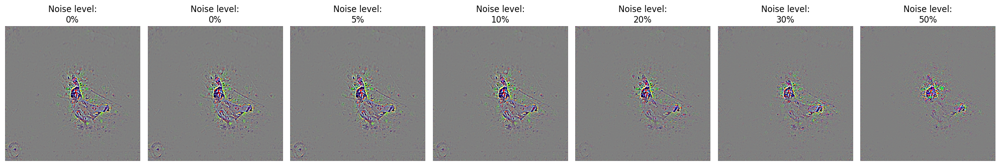

In [34]:
def plot_noise_levels(image_paths, guided_bp, noise_levels):
    input_image = preprocess_image(image_paths)
    original_backprop, results = smoothed_grad(input_image.squeeze(), guided_bp, add_gaussian_noise, normalize_image, noise_levels)

    fig, axes = plt.subplots(1, len(results) + 1, figsize=(20, 5))

    axes[0].imshow(original_backprop)
    axes[0].set_title(f'Noise level:\n0%')
    axes[0].axis('off')

    for i, result in enumerate(results):
        axes[i + 1].imshow(result)
        axes[i + 1].set_title(f'Noise level:\n{int(noise_levels[i] * 100)}%')
        axes[i + 1].axis('off')

    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    image_paths = '/kaggle/input/dataset-hw2-q2-tai/n01797886_ruffed_grouse.JPEG'  
    noise_levels = [0.0, 0.05, 0.1, 0.2, 0.3, 0.5]  # Different noise levels

    vgg_model = models.vgg19(weights=models.VGG19_Weights.IMAGENET1K_V1).to(device)
    guided_bp = GuidedBackprop(vgg_model)

    plot_noise_levels(image_paths, guided_bp, noise_levels)


Generating smoothed gradients: 100%|██████████| 6/6 [00:00<00:00, 22.81it/s]


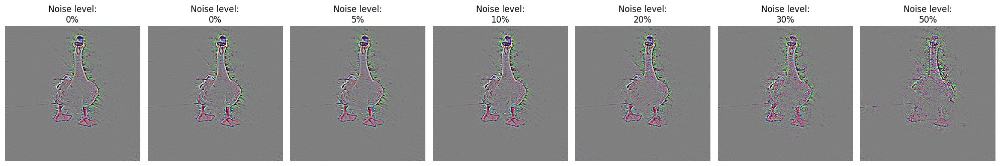

In [35]:
def plot_noise_levels(image_paths, guided_bp, noise_levels):
    input_image = preprocess_image(image_paths)
    original_backprop, results = smoothed_grad(input_image.squeeze(), guided_bp, add_gaussian_noise, normalize_image, noise_levels)

    fig, axes = plt.subplots(1, len(results) + 1, figsize=(20, 5))

    axes[0].imshow(original_backprop)
    axes[0].set_title(f'Noise level:\n0%')
    axes[0].axis('off')

    for i, result in enumerate(results):
        axes[i + 1].imshow(result)
        axes[i + 1].set_title(f'Noise level:\n{int(noise_levels[i] * 100)}%')
        axes[i + 1].axis('off')

    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    image_paths = '/kaggle/input/dataset-hw2-q2-tai/n01855672_goose.JPEG'  
    noise_levels = [0.0, 0.05, 0.1, 0.2, 0.3, 0.5]  # Different noise levels

    vgg_model = models.vgg19(weights=models.VGG19_Weights.IMAGENET1K_V1).to(device)
    guided_bp = GuidedBackprop(vgg_model)

    plot_noise_levels(image_paths, guided_bp, noise_levels)


Generating smoothed gradients: 100%|██████████| 6/6 [00:00<00:00, 22.90it/s]


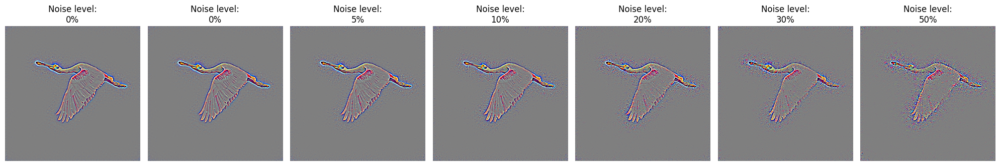

In [36]:
def plot_noise_levels(image_paths, guided_bp, noise_levels):
    input_image = preprocess_image(image_paths)
    original_backprop, results = smoothed_grad(input_image.squeeze(), guided_bp, add_gaussian_noise, normalize_image, noise_levels)

    fig, axes = plt.subplots(1, len(results) + 1, figsize=(20, 5))

    axes[0].imshow(original_backprop)
    axes[0].set_title(f'Noise level:\n0%')
    axes[0].axis('off')

    for i, result in enumerate(results):
        axes[i + 1].imshow(result)
        axes[i + 1].set_title(f'Noise level:\n{int(noise_levels[i] * 100)}%')
        axes[i + 1].axis('off')

    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    image_paths = '/kaggle/input/dataset-hw2-q2-tai/n02006656_spoonbill.JPEG'  
    noise_levels = [0.0, 0.05, 0.1, 0.2, 0.3, 0.5]  # Different noise levels

    vgg_model = models.vgg19(weights=models.VGG19_Weights.IMAGENET1K_V1).to(device)
    guided_bp = GuidedBackprop(vgg_model)

    plot_noise_levels(image_paths, guided_bp, noise_levels)


In [68]:
def load_image(image_path):
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    image = Image.open(image_path).convert('RGB')
    image = transform(image).unsqueeze(0)  # Add batch dimension
    return image


In [69]:
def fgsm_attack(image, epsilon, data_grad):
    sign_data_grad = data_grad.sign()
    perturbed_image = image + epsilon * sign_data_grad
    perturbed_image = torch.clamp(perturbed_image, 0, 1)
    return perturbed_image


In [70]:
def create_adversarial_image(model, image, epsilon):
    image.requires_grad = True
    output = model(image)
    init_pred = output.max(1)[1]  # get the index of the max log-probability

    loss = torch.nn.functional.cross_entropy(output, init_pred)
    model.zero_grad()
    loss.backward()
    data_grad = image.grad.data

    perturbed_image = fgsm_attack(image, epsilon, data_grad)
    return perturbed_image


In [71]:
class GuidedBackprop:
    def __init__(self, model):
        self.model = model
        self.model.eval()
        self.hooks = []
        for module in self.model.modules():
            if isinstance(module, torch.nn.ReLU):
                hook = module.register_backward_hook(self.clamp_grad)
                self.hooks.append(hook)

    def clamp_grad(self, module, grad_in, grad_out):
        if grad_in[0] is not None:
            return (torch.clamp(grad_in[0], min=0.0),)

    def visualize(self, image, target_class):
        image.requires_grad = True
        output = self.model(image)
        one_hot_output = torch.zeros_like(output)
        one_hot_output[0, target_class] = 1

        self.model.zero_grad()
        output.backward(gradient=one_hot_output)
        
        return image.grad

    def __del__(self):
        for hook in self.hooks:
            hook.remove()



In [72]:
def smoothgrad_saliency_map(image, model, iterations=50, noise_level=0.15):
    guided_bp = GuidedBackprop(model)
    total_grad = torch.zeros_like(image)

    initial_output = model(image)
    target_class = initial_output.argmax().item()  

    for _ in tqdm(range(iterations), desc="Generating smoothed gradients"):
        noisy_image = (image + torch.randn_like(image) * noise_level).detach().requires_grad_(True)
        grad = guided_bp.visualize(noisy_image, target_class)  
        total_grad += grad

    return total_grad / iterations


In [73]:
class GuidedBackprop:
    def __init__(self, model):
        self.model = model
        self.model.eval()
        self.hooks = []
        for module in self.model.modules():
            if isinstance(module, torch.nn.ReLU):
                hook = module.register_backward_hook(self.clamp_grad)
                self.hooks.append(hook)

    def clamp_grad(self, module, grad_in, grad_out):
        if grad_in[0] is not None:
            return (torch.clamp(grad_in[0], min=0.0),)

    def visualize(self, image, target_class):
        output = self.model(image)
        one_hot_output = torch.zeros_like(output)
        one_hot_output[0][target_class] = 1  

        self.model.zero_grad()
        output.backward(gradient=one_hot_output)

        return image.grad.data  

    def __del__(self):
        for hook in self.hooks:
            hook.remove()


Generating smoothed gradients: 100%|██████████| 50/50 [00:01<00:00, 31.67it/s]


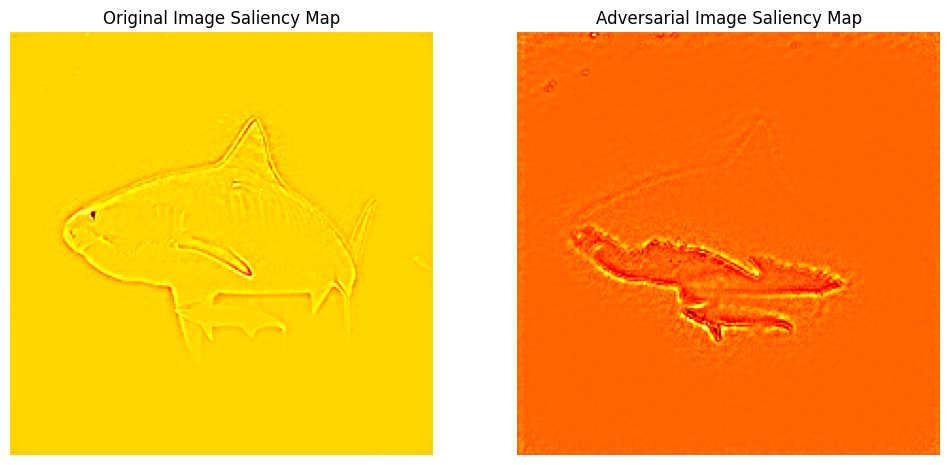

In [76]:
def main():
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = models.vgg19(pretrained=True).to(device).eval()

    image_path = '/kaggle/input/dataset-hw2-q2-tai/n01491361_tiger_shark.JPEG'
    original_image = load_image(image_path).to(device)

    epsilon = 0.01
    adversarial_image = create_adversarial_image(model, original_image.clone(), epsilon)

    original_saliency = smoothgrad_saliency_map(original_image, model)
    adversarial_saliency = smoothgrad_saliency_map(adversarial_image, model)
    plt.figure(figsize=(12, 6))
    original_saliency_np = original_saliency.squeeze().cpu().detach().permute(1, 2, 0).numpy()
    adversarial_saliency_np = adversarial_saliency.squeeze().cpu().detach().permute(1, 2, 0).numpy()
    plt.subplot(1, 2, 1)
    plt.imshow(original_saliency_np[:, :, 0], cmap='hot') 
    plt.title('Original Image Saliency Map')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(adversarial_saliency_np[:, :, 0], cmap='hot') 
    plt.title('Adversarial Image Saliency Map')
    plt.axis('off')

    plt.show()

if __name__ == '__main__':
    main()
